In [1]:
# import the necessary packages
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import Activation
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Dense
from tensorflow.keras import backend as K
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.utils import to_categorical

from sklearn.model_selection import train_test_split

from imutils import paths
import matplotlib.pyplot as plt
import numpy as np
import argparse
import random
import cv2
import os

import warnings
from tqdm import tqdm_notebook as tqdm
import itertools

import tensorflow as tf 
print(tf.__version__)
warnings.filterwarnings("ignore")
SEED = 42   # set random seed

2.12.0


In [2]:
model = Sequential()
model.add(Conv2D(20, (5, 5), padding="same",input_shape=(24,24,3)))
model.add(Activation("relu"))
model.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))
model.add(Flatten())
model.add(Dense(500))
model.add(Activation("relu"))
# softmax classifier
model.add(Dense(3))
model.add(Activation("softmax"))

In [3]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 24, 24, 20)        1520      
                                                                 
 activation (Activation)     (None, 24, 24, 20)        0         
                                                                 
 max_pooling2d (MaxPooling2D  (None, 12, 12, 20)       0         
 )                                                               
                                                                 
 flatten (Flatten)           (None, 2880)              0         
                                                                 
 dense (Dense)               (None, 500)               1440500   
                                                                 
 activation_1 (Activation)   (None, 500)               0         
                                                        

In [4]:
# create CNN Model
class LeNet:

    @staticmethod
    def build(width, height, depth, classes):
        # initialize the model
        model = Sequential()
        inputShape = (height, width, depth) # (h, h, chanel)

        # if we are using "channels first", update the input shape
        if K.image_data_format() == "channels_first":
            inputShape = (depth, height, width)

        # first set of CONV => RELU => POOL layers
        model.add(Conv2D(20, (5, 5), padding="same",input_shape=inputShape))
        model.add(Activation("relu"))
        model.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))

        # second set of CONV => RELU => POOL layers
        model.add(Conv2D(50, (5, 5), padding="same"))
        model.add(Activation("relu"))
        model.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))

        # second set of CONV => RELU => POOL layers
        model.add(Conv2D(100, (5, 5), padding="same"))
        model.add(Activation("relu"))
        model.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))

        # first (and only) set of FC => RELU layers
        model.add(Flatten())
        model.add(Dense(500))
        model.add(Activation("relu"))

        # softmax classifier
        model.add(Dense(classes))
        model.add(Activation("softmax"))

        # return the constructed network architecture
        return model


In [5]:
DATASET = "train"  # this folde must contain three subfolder with images
MODEL = "Scene.model" # name to store the model on disk
PLOT = "plot.png" # plot name

In [6]:
EPOCHS = 25
INIT_LR = 1e-3
BS = 32

In [7]:
import os
os.chdir("/content/drive/MyDrive/EXAM/PGA Wkend DL Exam/Datasets/CNN/Shoe Classification")

In [8]:
!dir 

flagged  test  train


In [9]:
# initialize the data and labels
print("[INFO] loading images...")
data = []
labels = []

# grab the image paths and randomly shuffle them
imagePaths = sorted(list(paths.list_images(DATASET)))
random.seed(42)
random.shuffle(imagePaths)

# progress bar 
with tqdm(total=len(imagePaths)) as pbar:
    
    # loop over the input images
    for idx, imagePath in enumerate(imagePaths):
        # load the image, pre-process it, and store it in the data list
        image = cv2.imread(imagePath)
        image = cv2.resize(image, (28, 28))
        image = img_to_array(image)
        data.append(image)

        # extract the class label from the image path and update the
        # labels list
        label = imagePath.split(os.path.sep)[-2]

        if label == "Boots":
            label = 0
        elif label == "Sandals":
            label = 1
        elif label == "Slippers":
            label = 2

        labels.append(label)
        # update the progressbar
        pbar.update(1)

[INFO] loading images...


  0%|          | 0/778 [00:00<?, ?it/s]

In [10]:
data[0]

array([[[255., 255., 255.],
        [255., 255., 255.],
        [255., 255., 255.],
        ...,
        [255., 254., 254.],
        [255., 255., 255.],
        [255., 255., 255.]],

       [[255., 255., 255.],
        [255., 255., 255.],
        [255., 255., 255.],
        ...,
        [ 13.,  20.,  29.],
        [255., 255., 255.],
        [255., 255., 255.]],

       [[255., 255., 255.],
        [255., 255., 255.],
        [255., 255., 255.],
        ...,
        [186., 178., 180.],
        [255., 255., 255.],
        [255., 255., 255.]],

       ...,

       [[255., 255., 255.],
        [255., 255., 255.],
        [ 20.,  23.,  24.],
        ...,
        [255., 255., 255.],
        [255., 255., 255.],
        [255., 255., 255.]],

       [[255., 255., 255.],
        [255., 255., 255.],
        [122., 127., 129.],
        ...,
        [255., 255., 255.],
        [255., 255., 255.],
        [255., 255., 255.]],

       [[255., 255., 255.],
        [255., 255., 255.],
        [253., 2

In [11]:
data[0].shape

(28, 28, 3)

In [12]:
data = np.array(data, dtype="float") / 255.0
labels = np.array(labels)

In [13]:
labels

array([1, 0, 0, 1, 0, 0, 2, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 2, 0, 2, 0,
       2, 0, 1, 2, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 2, 1, 1, 0, 2, 1,
       0, 2, 1, 0, 0, 2, 0, 1, 0, 2, 0, 2, 2, 0, 2, 1, 2, 1, 0, 0, 0, 1,
       2, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 2, 0, 1, 2, 2, 0, 0, 0,
       0, 1, 2, 1, 1, 1, 1, 0, 0, 0, 1, 2, 0, 1, 2, 0, 1, 0, 0, 1, 2, 0,
       1, 0, 1, 0, 1, 0, 1, 2, 1, 1, 1, 2, 2, 0, 1, 1, 1, 1, 0, 1, 1, 0,
       1, 1, 1, 1, 1, 2, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1,
       2, 1, 0, 2, 0, 1, 0, 1, 1, 2, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 2,
       0, 1, 0, 2, 1, 1, 2, 2, 2, 1, 0, 0, 0, 0, 0, 0, 2, 2, 1, 1, 0, 1,
       2, 1, 0, 2, 0, 1, 1, 0, 0, 1, 0, 0, 2, 1, 1, 1, 1, 1, 2, 1, 0, 0,
       1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 2, 1, 0, 0, 0, 0, 1, 1, 2, 2,
       1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 2, 0, 0, 0, 2, 2, 2, 0, 1, 2,
       1, 1, 2, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 2, 0, 1, 0,
       0, 0, 2, 1, 0, 0, 0, 2, 2, 1, 1, 1, 0, 1, 2,

In [14]:
(trainX, testX, trainY, testY) = train_test_split(data, labels, test_size=0.25, random_state=42)

In [15]:
trainX.shape

(583, 28, 28, 3)

In [16]:
trainY.shape

(583,)

In [17]:
trainY = to_categorical(trainY, num_classes=3)
testY = to_categorical(testY, num_classes=3)

In [18]:
trainY[0]

array([1., 0., 0.], dtype=float32)

# Data Preprocessing (Augumentation)

In [19]:
# construct the image generator for data augmentation
aug = ImageDataGenerator(rotation_range=30, 
                         width_shift_range=0.1, 
                         height_shift_range=0.1, 
                         shear_range=0.2, 
                         zoom_range=0.2, 
                         horizontal_flip=True, 
                         fill_mode="nearest")

In [20]:
# initialize the model
print("[INFO] compiling model...")
model = LeNet.build(width=28, height=28, depth=3, classes=3)


opt = Adam(lr=INIT_LR)

model.compile(loss="categorical_crossentropy", optimizer=opt, metrics=["accuracy"])

print("[INFO] model complied...")
EPOCHS = 50
INIT_LR = 1e-3
BS = 32

[INFO] compiling model...
[INFO] model complied...


In [21]:
print(model.summary())

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_1 (Conv2D)           (None, 28, 28, 20)        1520      
                                                                 
 activation_3 (Activation)   (None, 28, 28, 20)        0         
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 14, 14, 20)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 14, 14, 50)        25050     
                                                                 
 activation_4 (Activation)   (None, 14, 14, 50)        0         
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 7, 7, 50)         0         
 2D)                                                  

In [22]:
tf.config.experimental_run_functions_eagerly(True)

Instructions for updating:
Use `tf.config.run_functions_eagerly` instead of the experimental version.


In [23]:
# train the network
print("[INFO] training network...")
H = model.fit(x=aug.flow(trainX, trainY, batch_size=BS),
              validation_data=(testX, testY), 
              steps_per_epoch=len(trainX) // BS,
              epochs=130, 
              verbose=1)

[INFO] training network...
Epoch 1/130
18/18 [==============================] - 4s 106ms/step - loss: 1.0687 - accuracy: 0.3920 - val_loss: 0.9835 - val_accuracy: 0.5282
Epoch 2/130
18/18 [==============================] - 3s 165ms/step - loss: 0.8555 - accuracy: 0.6007 - val_loss: 0.5594 - val_accuracy: 0.7538
Epoch 3/130
18/18 [==============================] - 3s 195ms/step - loss: 0.7097 - accuracy: 0.6733 - val_loss: 0.5323 - val_accuracy: 0.7333
Epoch 4/130
18/18 [==============================] - 3s 150ms/step - loss: 0.6598 - accuracy: 0.7024 - val_loss: 0.5076 - val_accuracy: 0.7436
Epoch 5/130
18/18 [==============================] - 3s 157ms/step - loss: 0.6191 - accuracy: 0.7078 - val_loss: 0.4342 - val_accuracy: 0.8256
Epoch 6/130
18/18 [==============================] - 2s 107ms/step - loss: 0.5402 - accuracy: 0.7623 - val_loss: 0.3740 - val_accuracy: 0.8103
Epoch 7/130
18/18 [==============================] - 2s 102ms/step - loss: 0.5643 - accuracy: 0.7368 - val_loss: 0.

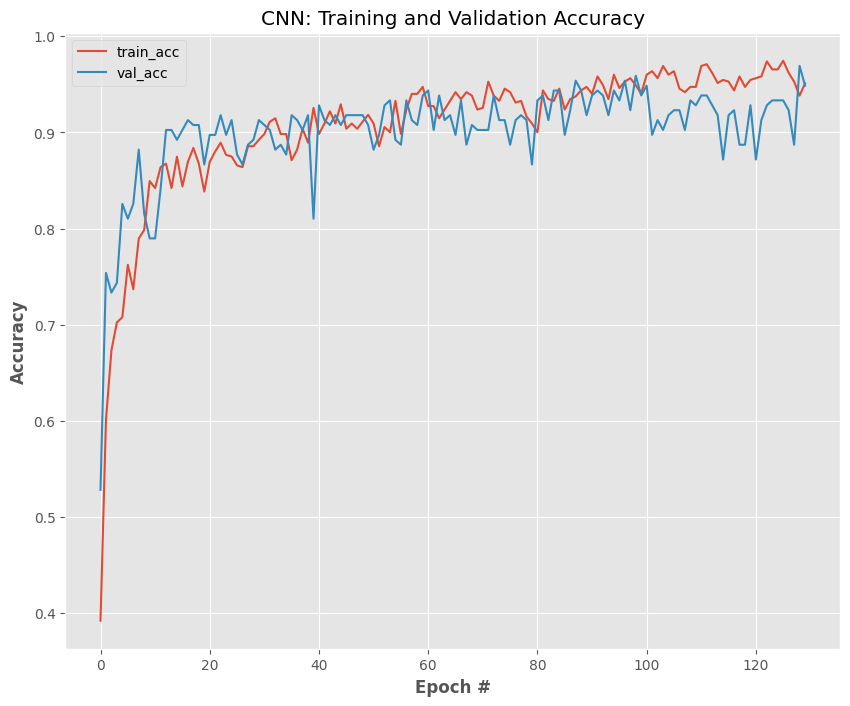

In [24]:
# plot the training and validation accuracy
N = np.arange(0, 130)
plt.style.use("ggplot")
plt.figure(figsize = [10,8])
plt.plot(N, H.history["accuracy"], label="train_acc")
plt.plot(N, H.history["val_accuracy"], label="val_acc")
plt.title("CNN: Training and Validation Accuracy")
plt.xlabel("Epoch #", weight="bold")
plt.ylabel("Accuracy", weight="bold")
plt.legend()
plt.show()

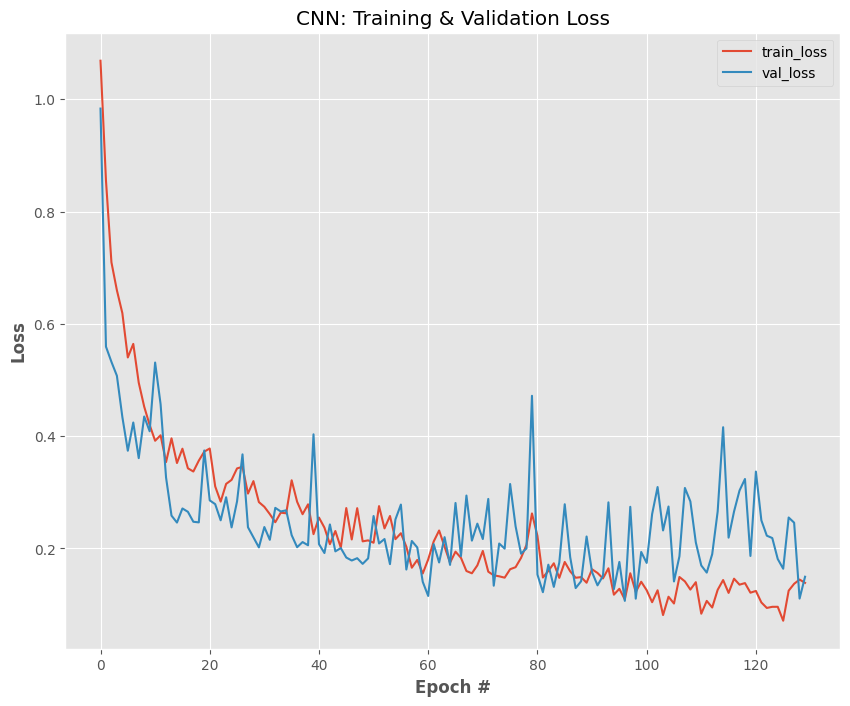

In [25]:
# plot the training and validation loss
N = np.arange(0, 130)
plt.style.use("ggplot")
plt.figure(figsize = [10,8])
plt.plot(N, H.history["loss"], label="train_loss")
plt.plot(N, H.history["val_loss"], label="val_loss")
plt.title("CNN: Training & Validation Loss")
plt.xlabel("Epoch #", weight="bold")
plt.ylabel("Loss", weight="bold")
plt.legend()
plt.show()

In [26]:
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.models import load_model
import numpy as np
import argparse
import imutils
import cv2
import matplotlib.pyplot as plt
from imutils import paths
%matplotlib inline

In [27]:
def display_img(img):
    fig = plt.figure(figsize=(12,10))
    # plt.grid(b=None)
    ax = fig.add_subplot(111)

    ax.imshow(img)

In [28]:
!dir


flagged  test  train


In [29]:
from tqdm import tqdm

In [30]:
# import the necessary packages
from tensorflow.keras.models import load_model
import pickle
import cv2

# # load the model 
print("[INFO] loading network and...")
# model = load_model(MODEL)

# grab the image paths and randomly shuffle themt
testImagePaths = sorted(list(paths.list_images('test'))) 

all_class = ["Boots ", "Sandals", "Slippers"]

[INFO] loading network and...


In [31]:
# !pip install imutils\
import imutils

  0%|          | 0/89 [00:00<?, ?it/s]

1/1 [==============================] - 0s 119ms/step


  1%|          | 1/89 [00:00<00:20,  4.19it/s]

[3.6439796e-09 9.9922180e-01 7.7813829e-04]
1/1 [==============================] - 0s 30ms/step


  2%|▏         | 2/89 [00:00<00:13,  6.34it/s]

[9.8559266e-01 1.4120467e-02 2.8679878e-04]
1/1 [==============================] - 0s 31ms/step
[9.9799973e-01 1.7549709e-03 2.4534814e-04]
1/1 [==============================] - 0s 27ms/step
[1.6353653e-06 1.5930913e-04 9.9983907e-01]


  4%|▍         | 4/89 [00:00<00:10,  8.26it/s]

1/1 [==============================] - 0s 26ms/step
[9.9990427e-01 9.5676209e-05 5.7349204e-08]


  6%|▌         | 5/89 [00:00<00:09,  8.67it/s]

1/1 [==============================] - 0s 29ms/step
[0.00140641 0.9549377  0.04365586]
1/1 [==============================] - 0s 25ms/step
[9.9999714e-01 2.8116310e-06 2.0300045e-10]


  8%|▊         | 7/89 [00:00<00:08,  9.63it/s]

1/1 [==============================] - 0s 37ms/step
[1.1340598e-04 9.9986565e-01 2.0964677e-05]


  9%|▉         | 8/89 [00:00<00:08,  9.70it/s]

1/1 [==============================] - 0s 25ms/step
[1.0089880e-04 9.9955434e-01 3.4470877e-04]
1/1 [==============================] - 0s 24ms/step
[9.9999547e-01 4.4960348e-06 9.2105337e-11]


 11%|█         | 10/89 [00:01<00:07, 10.22it/s]

1/1 [==============================] - 0s 25ms/step
[9.9999809e-01 1.8934342e-06 9.5344366e-10]
1/1 [==============================] - 0s 24ms/step
[9.9999893e-01 1.0294098e-06 4.1611453e-10]


 13%|█▎        | 12/89 [00:01<00:07, 10.75it/s]

1/1 [==============================] - 0s 25ms/step
[6.5289283e-01 3.4646297e-01 6.4422627e-04]
1/1 [==============================] - 0s 30ms/step
[9.9821520e-01 1.7786532e-03 6.2443082e-06]


 16%|█▌        | 14/89 [00:01<00:06, 10.86it/s]

1/1 [==============================] - 0s 26ms/step
[9.7363561e-01 2.6140450e-02 2.2388033e-04]
1/1 [==============================] - 0s 26ms/step
[9.9994159e-01 5.8403104e-05 1.9217696e-08]


 18%|█▊        | 16/89 [00:01<00:09,  7.78it/s]

1/1 [==============================] - 0s 26ms/step
[1.6109207e-05 9.9661714e-01 3.3667325e-03]
1/1 [==============================] - 0s 29ms/step


 20%|██        | 18/89 [00:02<00:08,  8.61it/s]

[4.2172051e-03 9.9489081e-01 8.9199457e-04]
1/1 [==============================] - 0s 26ms/step
[2.9729305e-05 9.6802181e-01 3.1948399e-02]


 21%|██▏       | 19/89 [00:02<00:07,  8.83it/s]

1/1 [==============================] - 0s 25ms/step
[3.2710141e-05 9.9911553e-01 8.5175846e-04]
1/1 [==============================] - 0s 25ms/step
[1.4950234e-06 9.9992132e-01 7.7167402e-05]


 24%|██▎       | 21/89 [00:02<00:07,  9.55it/s]

1/1 [==============================] - 0s 27ms/step
[2.1247684e-04 6.9831955e-01 3.0146801e-01]
1/1 [==============================] - 0s 31ms/step
[9.9999797e-01 2.0307907e-06 8.4190495e-11]


 26%|██▌       | 23/89 [00:02<00:06,  9.79it/s]

1/1 [==============================] - 0s 26ms/step
[0.00944318 0.9849214  0.00563536]
1/1 [==============================] - 0s 26ms/step
[9.9945337e-01 5.4584665e-04 8.0584124e-07]


 28%|██▊       | 25/89 [00:02<00:06, 10.06it/s]

1/1 [==============================] - 0s 26ms/step
[9.9853444e-01 1.4484187e-03 1.7158798e-05]
1/1 [==============================] - 0s 29ms/step


 30%|███       | 27/89 [00:02<00:06, 10.07it/s]

[9.9999726e-01 2.7394840e-06 7.4060424e-10]
1/1 [==============================] - 0s 26ms/step
[9.9997067e-01 2.9306286e-05 3.9138275e-09]
1/1 [==============================] - 0s 26ms/step
[6.3303128e-06 3.5249714e-03 9.9646866e-01]


 33%|███▎      | 29/89 [00:03<00:05, 10.44it/s]

1/1 [==============================] - 0s 26ms/step
[3.6777456e-05 6.6932584e-03 9.9326998e-01]
1/1 [==============================] - 0s 28ms/step


 35%|███▍      | 31/89 [00:03<00:05, 10.72it/s]

[9.7826982e-01 2.1725079e-02 5.1838038e-06]
1/1 [==============================] - 0s 24ms/step
[9.996865e-01 3.129532e-04 6.416892e-07]
1/1 [==============================] - 0s 25ms/step
[9.9812561e-01 1.6289399e-03 2.4547576e-04]


 37%|███▋      | 33/89 [00:03<00:05, 10.76it/s]

1/1 [==============================] - 0s 31ms/step
[9.9997520e-01 2.4830939e-05 9.1661754e-09]
1/1 [==============================] - 0s 24ms/step
[9.9999869e-01 1.3485279e-06 4.8779619e-10]


 39%|███▉      | 35/89 [00:03<00:05, 10.61it/s]

1/1 [==============================] - 0s 25ms/step
[9.9999738e-01 2.6402256e-06 1.1626961e-10]
1/1 [==============================] - 0s 26ms/step
[9.9972993e-01 2.6373658e-04 6.2885074e-06]


 42%|████▏     | 37/89 [00:03<00:04, 10.61it/s]

1/1 [==============================] - 0s 25ms/step
[9.9985576e-01 8.1049737e-05 6.3114428e-05]
1/1 [==============================] - 0s 28ms/step
[9.1718453e-01 8.2615905e-02 1.9955011e-04]


 44%|████▍     | 39/89 [00:04<00:04, 10.59it/s]

1/1 [==============================] - 0s 27ms/step
[9.9990344e-01 6.5533248e-05 3.0963536e-05]
1/1 [==============================] - 0s 24ms/step
[9.99331236e-01 6.68627326e-04 1.06828445e-07]


 46%|████▌     | 41/89 [00:04<00:04, 10.55it/s]

1/1 [==============================] - 0s 25ms/step
[9.9999797e-01 1.9930962e-06 1.8204842e-10]
1/1 [==============================] - 0s 25ms/step
[9.8187983e-01 1.8109104e-02 1.1021135e-05]


 48%|████▊     | 43/89 [00:04<00:04, 10.60it/s]

1/1 [==============================] - 0s 25ms/step
[1.9333707e-04 9.0617168e-01 9.3634978e-02]
1/1 [==============================] - 0s 32ms/step
[9.084812e-10 9.999994e-01 5.452635e-07]


 51%|█████     | 45/89 [00:04<00:04, 10.45it/s]

1/1 [==============================] - 0s 28ms/step
[5.7797189e-07 9.9749714e-01 2.5022593e-03]
1/1 [==============================] - 0s 25ms/step
[0.00103958 0.02425554 0.9747048 ]


 53%|█████▎    | 47/89 [00:04<00:04, 10.46it/s]

1/1 [==============================] - 0s 27ms/step
[2.7677357e-05 5.0672069e-03 9.9490511e-01]
1/1 [==============================] - 0s 27ms/step
[2.9148289e-08 9.9999869e-01 1.3324473e-06]


 55%|█████▌    | 49/89 [00:04<00:03, 10.51it/s]

1/1 [==============================] - 0s 27ms/step
[0.00626766 0.9400001  0.05373223]
1/1 [==============================] - 0s 30ms/step
[0.00190918 0.05459819 0.94349265]


 57%|█████▋    | 51/89 [00:05<00:03, 10.41it/s]

1/1 [==============================] - 0s 27ms/step
[8.6983746e-01 1.3013606e-01 2.6532969e-05]
1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 53/89 [00:05<00:03, 10.25it/s]

[1.2469154e-07 9.9999702e-01 2.8112204e-06]
1/1 [==============================] - 0s 24ms/step
[6.2415464e-04 7.8309424e-02 9.2106646e-01]
1/1 [==============================] - 0s 27ms/step
[8.0014062e-05 7.4305081e-01 2.5686917e-01]


 62%|██████▏   | 55/89 [00:05<00:03, 10.48it/s]

1/1 [==============================] - 0s 25ms/step
[9.914199e-01 8.579594e-03 5.071733e-07]
1/1 [==============================] - 0s 42ms/step


 64%|██████▍   | 57/89 [00:05<00:03, 10.03it/s]

[2.9014487e-05 3.6707041e-01 6.3290066e-01]
1/1 [==============================] - 0s 36ms/step
[8.756677e-14 8.671564e-06 9.999913e-01]
1/1 [==============================] - 0s 35ms/step


 66%|██████▋   | 59/89 [00:05<00:03,  9.47it/s]

[1.7005513e-11 7.6622182e-06 9.9999237e-01]
1/1 [==============================] - 0s 40ms/step


 67%|██████▋   | 60/89 [00:06<00:03,  9.24it/s]

[1.5785685e-05 1.3661161e-01 8.6337262e-01]
1/1 [==============================] - 0s 36ms/step


 69%|██████▊   | 61/89 [00:06<00:03,  9.02it/s]

[2.5851899e-03 9.9729472e-01 1.2003747e-04]
1/1 [==============================] - 0s 37ms/step


 70%|██████▉   | 62/89 [00:06<00:03,  8.70it/s]

[3.4693417e-09 9.9988985e-01 1.1016539e-04]
1/1 [==============================] - 0s 37ms/step


 71%|███████   | 63/89 [00:06<00:03,  8.46it/s]

[9.247692e-04 9.939154e-01 5.159847e-03]
1/1 [==============================] - 0s 37ms/step


 72%|███████▏  | 64/89 [00:06<00:02,  8.40it/s]

[1.2076576e-04 8.9086771e-01 1.0901160e-01]
1/1 [==============================] - 0s 42ms/step


 73%|███████▎  | 65/89 [00:06<00:03,  7.88it/s]

[0.27990127 0.6923558  0.02774291]
1/1 [==============================] - 0s 33ms/step


 74%|███████▍  | 66/89 [00:06<00:02,  7.93it/s]

[9.2424903e-05 1.2217567e-01 8.7773186e-01]
1/1 [==============================] - 0s 37ms/step


 75%|███████▌  | 67/89 [00:07<00:02,  7.97it/s]

[9.9954838e-01 4.3769678e-04 1.3971403e-05]
1/1 [==============================] - 0s 35ms/step


 76%|███████▋  | 68/89 [00:07<00:02,  7.95it/s]

[0.3062148  0.5262617  0.16752353]
1/1 [==============================] - 0s 43ms/step


 78%|███████▊  | 69/89 [00:07<00:02,  7.92it/s]

[1.9838421e-10 1.8114388e-05 9.9998188e-01]
1/1 [==============================] - 0s 37ms/step


 79%|███████▊  | 70/89 [00:07<00:02,  8.04it/s]

[5.4576049e-07 2.8930003e-02 9.7106946e-01]
1/1 [==============================] - 0s 33ms/step


 80%|███████▉  | 71/89 [00:07<00:02,  8.23it/s]

[7.4118441e-05 5.8911894e-02 9.4101399e-01]
1/1 [==============================] - 0s 42ms/step


 81%|████████  | 72/89 [00:07<00:02,  8.21it/s]

[7.2982066e-06 5.4740995e-02 9.4525170e-01]
1/1 [==============================] - 0s 37ms/step
[1.04103365e-05 9.54190195e-02 9.04570639e-01]


 82%|████████▏ | 73/89 [00:08<00:03,  4.79it/s]

1/1 [==============================] - 0s 36ms/step


 83%|████████▎ | 74/89 [00:08<00:02,  5.45it/s]

[1.510114e-08 4.130822e-06 9.999958e-01]
1/1 [==============================] - 0s 36ms/step


 84%|████████▍ | 75/89 [00:08<00:02,  6.17it/s]

[2.6938170e-07 2.9330652e-03 9.9706668e-01]
1/1 [==============================] - 0s 38ms/step


 85%|████████▌ | 76/89 [00:08<00:01,  6.72it/s]

[0.00368268 0.04071641 0.9556009 ]
1/1 [==============================] - 0s 36ms/step


 87%|████████▋ | 77/89 [00:08<00:01,  7.16it/s]

[3.2075859e-05 1.3006667e-03 9.9866724e-01]
1/1 [==============================] - 0s 36ms/step


 88%|████████▊ | 78/89 [00:08<00:01,  7.37it/s]

[8.9493449e-05 6.5486175e-01 3.4504879e-01]
1/1 [==============================] - 0s 40ms/step
[1.8081968e-04 2.4420157e-02 9.7539902e-01]


 89%|████████▉ | 79/89 [00:08<00:01,  6.68it/s]

1/1 [==============================] - 0s 34ms/step
[1.4342614e-06 3.9227620e-01 6.0772234e-01]


 90%|████████▉ | 80/89 [00:08<00:01,  6.94it/s]

1/1 [==============================] - 0s 36ms/step


 91%|█████████ | 81/89 [00:09<00:01,  6.97it/s]

[1.1063779e-07 3.8526729e-02 9.6147317e-01]
1/1 [==============================] - 0s 40ms/step


 92%|█████████▏| 82/89 [00:09<00:00,  7.16it/s]

[3.6887664e-09 9.9998164e-01 1.8356772e-05]
1/1 [==============================] - 0s 42ms/step


 93%|█████████▎| 83/89 [00:09<00:00,  7.15it/s]

[0.00205378 0.9373184  0.06062775]
1/1 [==============================] - 0s 42ms/step


 94%|█████████▍| 84/89 [00:09<00:00,  7.12it/s]

[6.72127819e-04 1.07377976e-01 8.91949952e-01]
1/1 [==============================] - 0s 36ms/step


 96%|█████████▌| 85/89 [00:09<00:00,  7.28it/s]

[1.8634650e-04 9.9755621e-01 2.2573988e-03]
1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 86/89 [00:09<00:00,  7.76it/s]

[3.4278921e-05 9.9980944e-01 1.5624493e-04]
1/1 [==============================] - 0s 28ms/step
[6.5426773e-04 9.9858785e-01 7.5793540e-04]
1/1 [==============================] - 0s 25ms/step
[1.910354e-06 6.894625e-03 9.931035e-01]


 99%|█████████▉| 88/89 [00:09<00:00,  8.91it/s]

1/1 [==============================] - 0s 24ms/step
[5.9235492e-05 2.2189264e-01 7.7804810e-01]


100%|██████████| 89/89 [00:10<00:00,  8.88it/s]


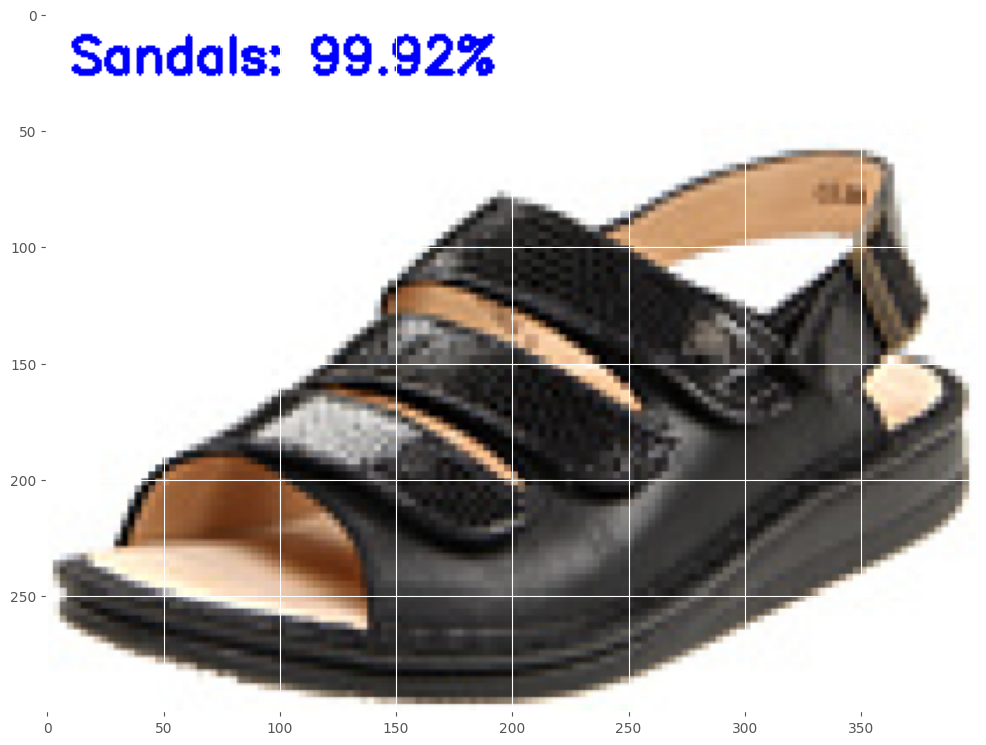

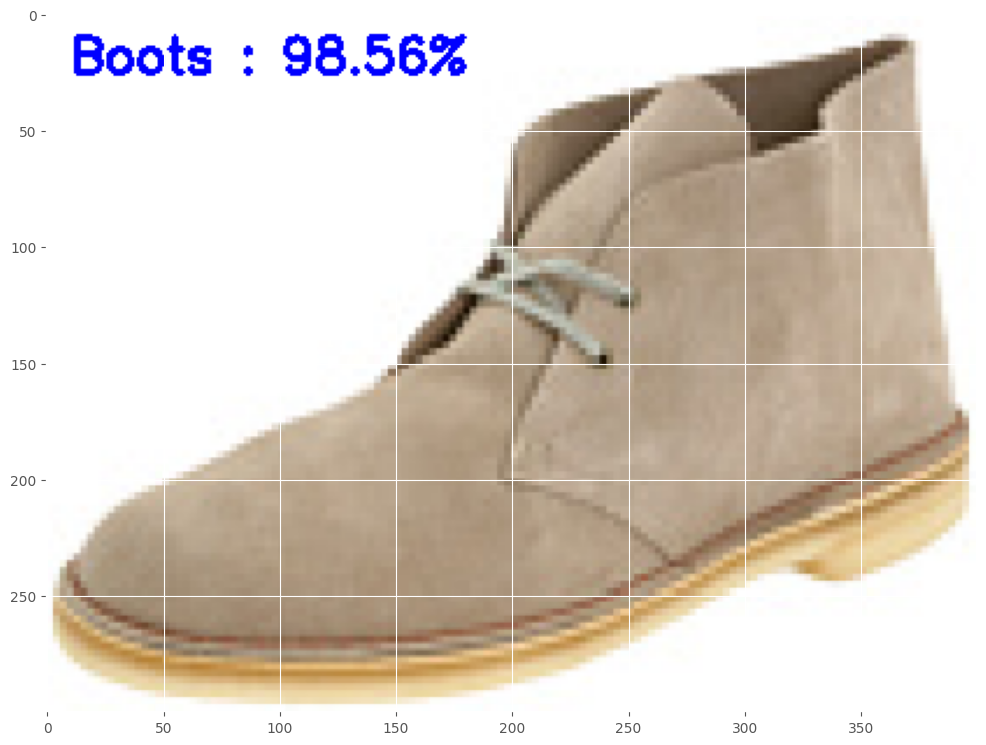

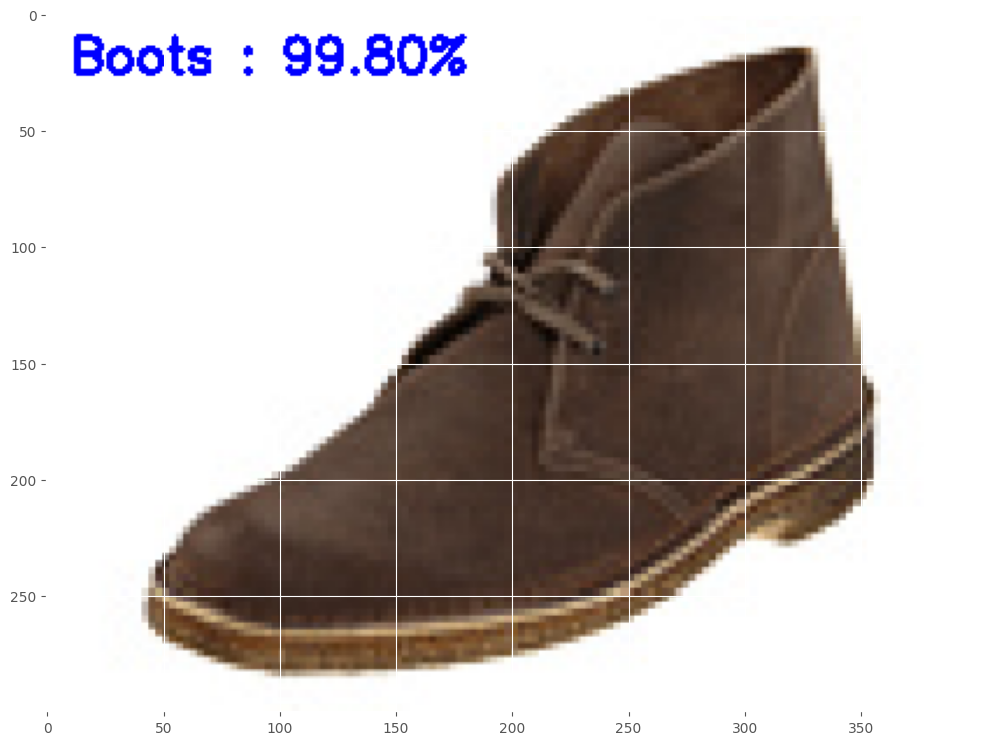

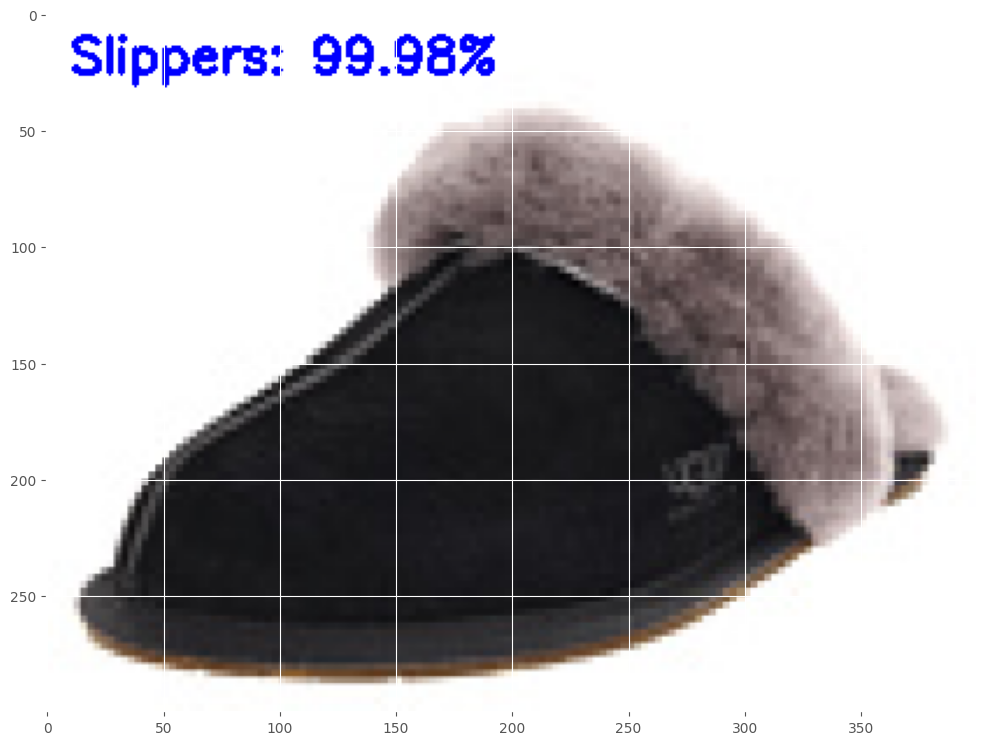

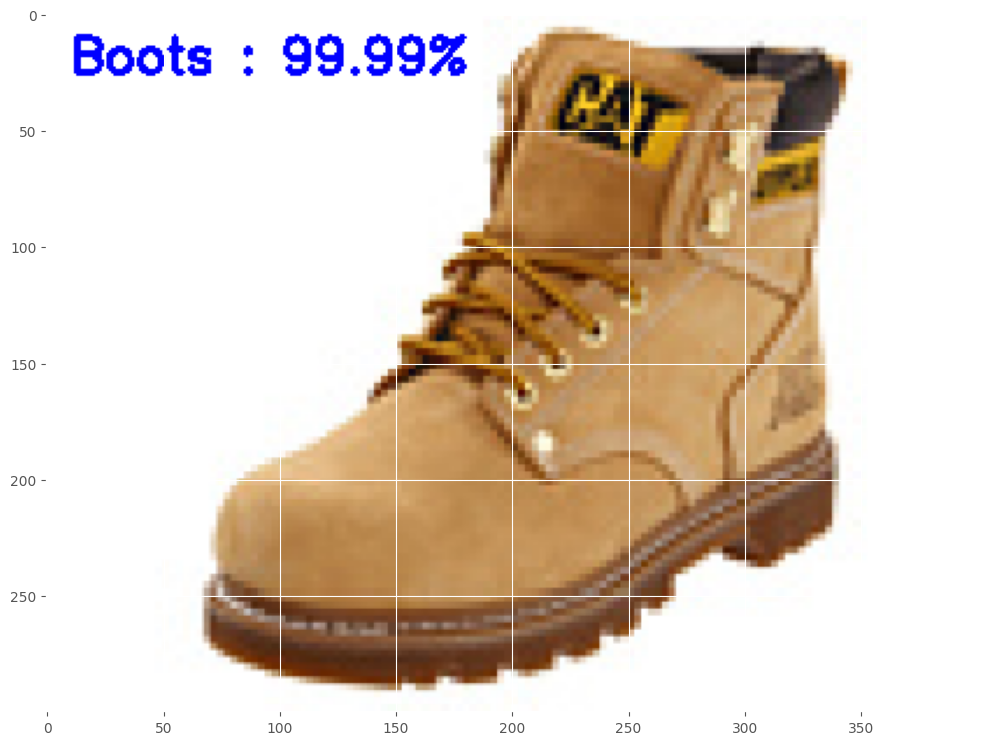

...

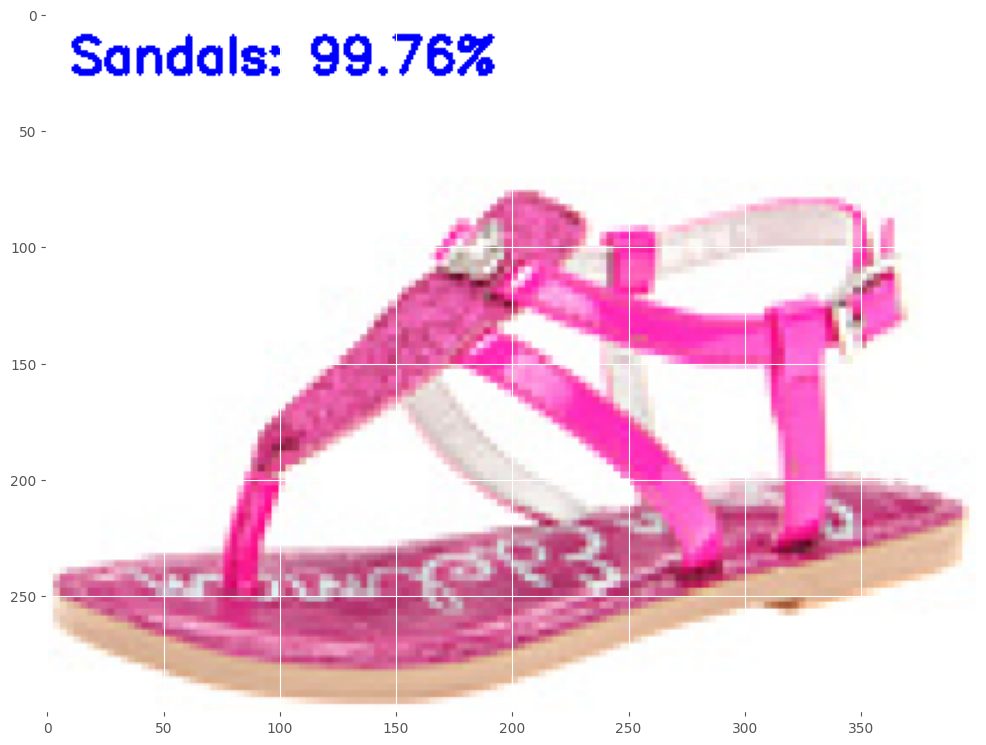

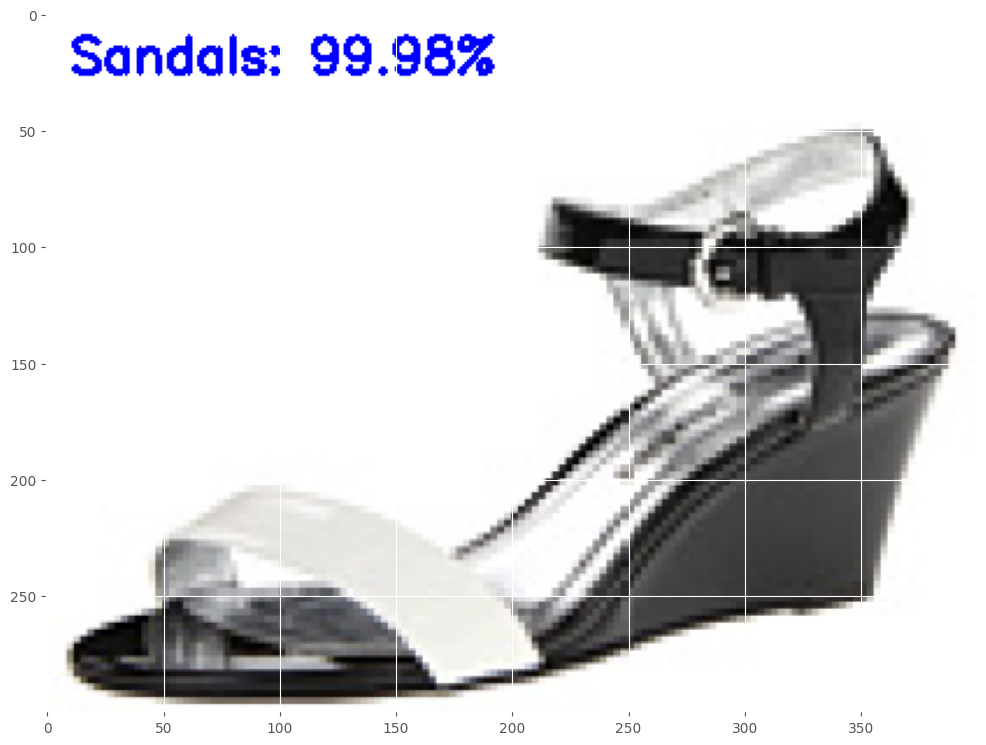

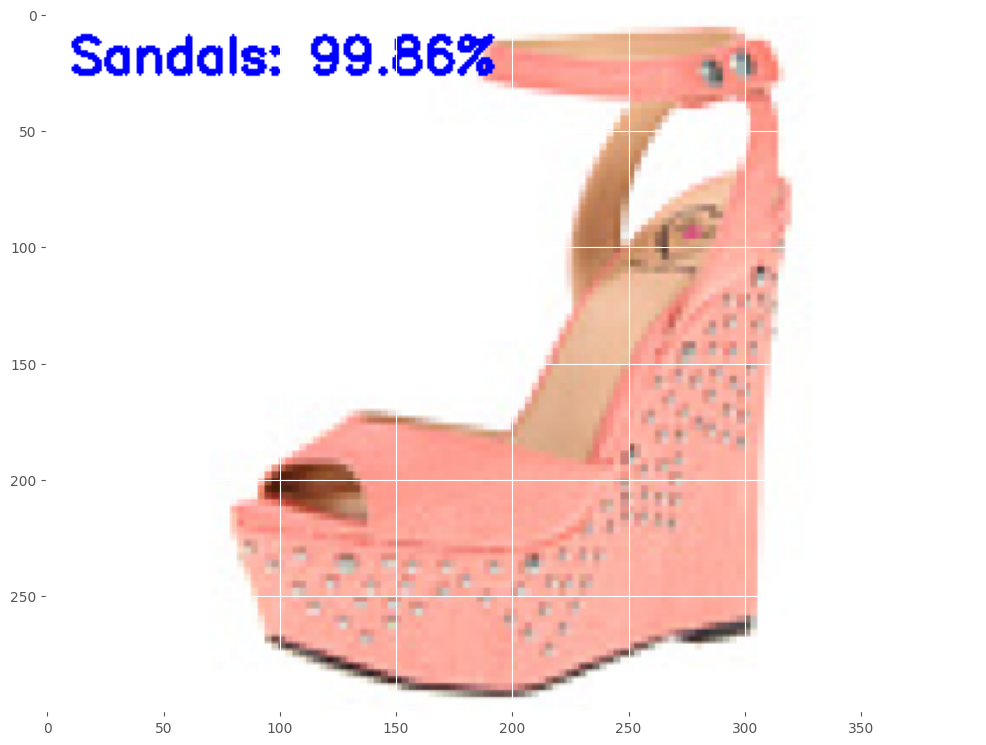

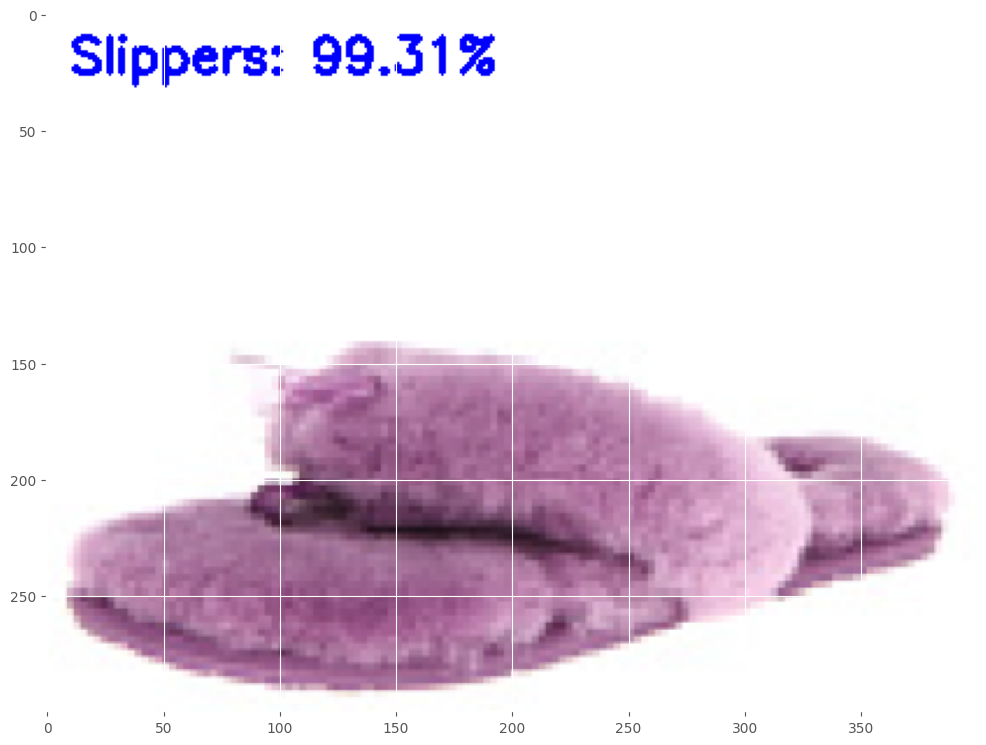

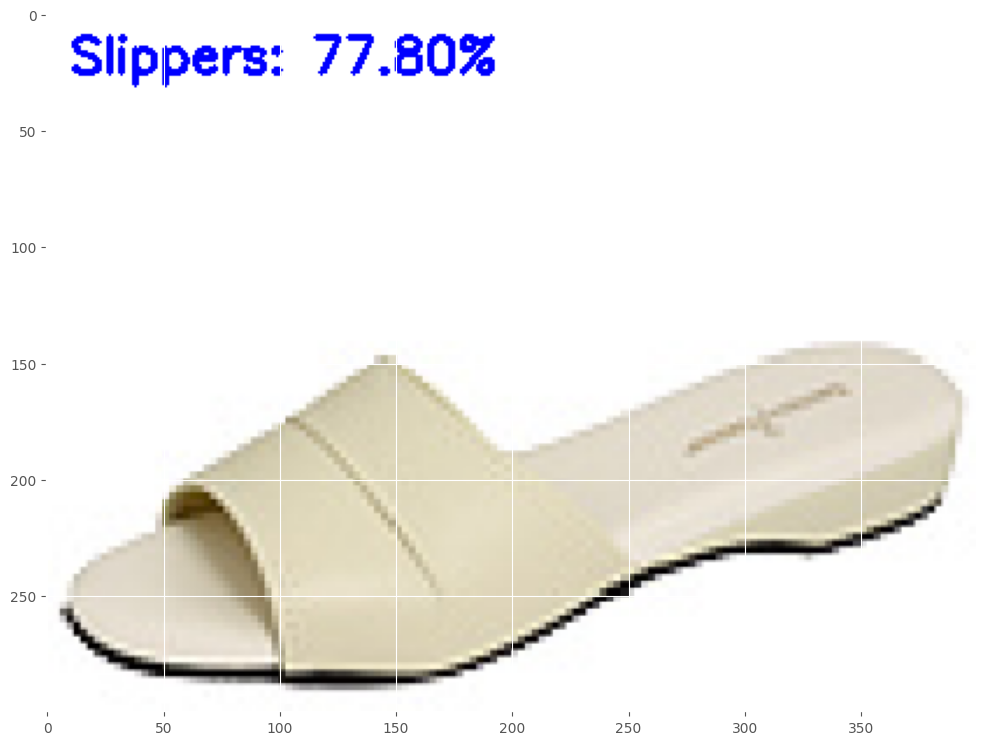

In [32]:
# progress bar 
with tqdm(total=len(testImagePaths)) as pbar:
    
    for imagePath in testImagePaths:
        
        # load the image
        image = cv2.imread(imagePath)
        orig = image.copy()

        # pre-process the image for classification
        image = cv2.resize(image, (28, 28))
        image = image.astype("float") / 255.0
        image = img_to_array(image)
        image = np.expand_dims(image, axis=0)

        # classify the input image
        prd_conf= model.predict(image)[0] # [[0.1 , 0.8 , 0.1]]
        print(prd_conf)

        # build the label
        label = all_class[np.argmax(prd_conf)] #[b f s]-> f
        proba = prd_conf[np.argmax(prd_conf)] # [0.1 , 0.8 , 0.1]  -> 0.8

        label = "{}: {:.2f}%".format(label, proba * 100)

        # draw the label on the image
        output = imutils.resize(orig, width=400)
        cv2.putText(output, label, (10, 25),  cv2.FONT_HERSHEY_SIMPLEX,
            0.7, (255, 0, 0), 2)
        
        # convert img to rgb format and display in notebook
        img = cv2.cvtColor(output, cv2.COLOR_BGR2RGB)
        display_img(img)
        
        pbar.update(1)


In [33]:
def predict_image(image):
    # load the image
    
    # pre-process the image for classification
    image = cv2.resize(image, (28, 28))
    image = image.astype("float") / 255.0
    image = img_to_array(image)
    image = np.expand_dims(image, axis=0)

        
    preds = model.predict(image)[0]
    result = dict()
    result["Boots"] = round(float(list(preds)[0]), 3)
    result["Sandals"] = round(float(list(preds)[1]), 3)
    result["Slippers"] = round(float(list(preds)[2]), 3)
    
    print(result)
    
    return result

In [34]:
# !pip install gradio

In [35]:
import gradio as gr

In [36]:
im = gr.inputs.Image(shape=(32,32))
label = gr.outputs.Label(num_top_classes=3)

gr.Interface(fn=predict_image, inputs=im, outputs=label, capture_session=True, title="Boots_CNN").launch(share=True)

Colab notebook detected. To show errors in colab notebook, set debug=True in launch()
Running on public URL: https://cd906ef04067e86cb6.gradio.live

This share link expires in 72 hours. For free permanent hosting and GPU upgrades (NEW!), check out Spaces: https://huggingface.co/spaces
